# Recognition Sample Run
Sample run of the recognition pipeline. Runs the model on all the clothing images in my specified folder to generate and labels tags and descriptive features for each image into a csv.

In [ ]:
%%capture
# Install required packages
!pip install git+https://github.com/huggingface/transformers
!pip install accelerate
!pip install torch
!pip install pandas
!pip install numpy
!pip install huggingface_hub[hf_transfer]
!pip install qwen-vl-utils[decord]==0.0.8

In [ ]:
import pandas as pd
import numpy as np

import os
import random
from PIL import Image as PIL_Image
import tempfile
import io
from pathlib import Path
from IPython.display import Image
from PIL import ImageEnhance
import json
from typing import Union, Dict, List

import torch
from huggingface_hub import hf_hub_download, snapshot_download
from transformers import Qwen2_5_VLForConditionalGeneration, AutoTokenizer, AutoProcessor
from qwen_vl_utils import process_vision_info

## Download Model

In [ ]:
# Define the model repository ID
repo_id = "Qwen/Qwen2.5-VL-7B-Instruct"

# Download the model file using hf_transfer
file_path = snapshot_download(repo_id)

print(f"Model downloaded to: {file_path}")

Fetching 16 files:   0%|          | 0/16 [00:00<?, ?it/s]

.gitattributes:   0%|          | 0.00/1.52k [00:00<?, ?B/s]

README.md:   0%|          | 0.00/18.6k [00:00<?, ?B/s]

config.json:   0%|          | 0.00/1.37k [00:00<?, ?B/s]

generation_config.json:   0%|          | 0.00/244 [00:00<?, ?B/s]

model-00001-of-00005.safetensors:   0%|          | 0.00/3.90G [00:00<?, ?B/s]

model-00002-of-00005.safetensors:   0%|          | 0.00/3.86G [00:00<?, ?B/s]

chat_template.json:   0%|          | 0.00/1.05k [00:00<?, ?B/s]

merges.txt:   0%|          | 0.00/1.67M [00:00<?, ?B/s]

model-00003-of-00005.safetensors:   0%|          | 0.00/3.86G [00:00<?, ?B/s]

model-00004-of-00005.safetensors:   0%|          | 0.00/3.86G [00:00<?, ?B/s]

model.safetensors.index.json:   0%|          | 0.00/57.6k [00:00<?, ?B/s]

model-00005-of-00005.safetensors:   0%|          | 0.00/1.09G [00:00<?, ?B/s]

preprocessor_config.json:   0%|          | 0.00/350 [00:00<?, ?B/s]

tokenizer.json:   0%|          | 0.00/7.03M [00:00<?, ?B/s]

tokenizer_config.json:   0%|          | 0.00/7.23k [00:00<?, ?B/s]

vocab.json:   0%|          | 0.00/2.78M [00:00<?, ?B/s]

Model downloaded to: /root/.cache/huggingface/hub/models--Qwen--Qwen2.5-VL-7B-Instruct/snapshots/6e6556e8ce728c7b3e438d75ebf04ec93403dc19


In [ ]:
model = Qwen2_5_VLForConditionalGeneration.from_pretrained(
    "Qwen/Qwen2.5-VL-7B-Instruct", torch_dtype="auto", device_map="auto"
)

processor = AutoProcessor.from_pretrained("Qwen/Qwen2.5-VL-7B-Instruct")

Loading checkpoint shards:   0%|          | 0/5 [00:00<?, ?it/s]

Using a slow image processor as `use_fast` is unset and a slow processor was saved with this model. `use_fast=True` will be the default behavior in v4.48, even if the model was saved with a slow processor. This will result in minor differences in outputs. You'll still be able to use a slow processor with `use_fast=False`.


## Define Prompt
Updated Prompt to include more features and format into a json string as the output.

In [ ]:
prompt = """
You are a fashion expert and product description generator. Your task is to analyze clothing product images and generate detailed and accurate descriptions. Include the following attributes in your descriptions:
- Category (either Outerwear, Top, Bottom, or Footwear)
- Type of clothing
- Primary Color
- Accent Color(s)
- Pattern
- Shape
- Fit (e.g., slim-fit, oversized, relaxed, etc.)
- Neckline (e.g., Crew, v-neck, scoop, not applicable, etc.)
- Key design elements (describe relevant elements. e.g., buttons, zippers, pleats, embellishments, stitching patterns, etc.)
- Brand (if specified)
- Style (e.g., streetwear, minimalist, athleisure, classic/traditional, etc.)
- Occasion suitability (e.g., casual, formal, sporty, etc.)
- Weather appropriateness (e.g., warm, cold, all-season)
- Fabric Material (e.g., cotton, wool, silk, denim, etc.)
- Fabric Weight
- Functional Features (e.g. water resistant, moisture-wicking, insulated, etc.)
- How it can be styled (2-3 sentences describing how the piece can be worn)
- Additional Notes (2-3 sentences describing the overall aesthetic of the piece and its essence)

Your descriptions should be professional and detailed enough to help a recommendation system that suggests outfit combinations based on occasion, style, and weather.
Format your response in JSON with the attribute name as the key and the corresponding description as the value.
"""

## Functions used to run recognition
We are scaling down the image before running the  model. Images taken on iphone (12) are 3024 × 4032, so the reduced size would be 756 x 1008 when using a scale of 4. We also increase the contrast in order to offset the color muting caused by downsampling.

In [ ]:
def reduce_image_size(image_path, scale=4, interpolation=PIL_Image.LANCZOS):
    img = PIL_Image.open(image_path)

    enhancer = ImageEnhance.Contrast(img)
    contrast_enhanced = enhancer.enhance(1.5) # Increase contrast by 50%
    enhancer = ImageEnhance.Color(contrast_enhanced)
    color_enhanced = enhancer.enhance(1.3) # Increase saturation by 30%

    # Convert to RGB if necessary
    if img.mode != 'RGB':
        img = img.convert('RGB')

    # Get original dimensions
    width, height = img.size

    # Calculate new dimensions
    new_width = width // scale
    new_height = height // scale

    # Resize the image using the specified interpolation method
    resized_img = color_enhanced.resize((new_width, new_height), interpolation)

    # Create a temporary file path
    temp_path = os.path.join(tempfile.gettempdir(), 'resized_image.png')

    # Save the resized image with original color profile and no compression
    resized_img.save(temp_path)

    return temp_path

In [ ]:
def run_one_recognition(image_path):
  # save reduced size image in temp path
  temp_path = reduce_image_size(image_path)

  # define message with image and prompt
  messages = [
      {
          "role": "user",
          "content": [
              {
                  "type": "image",
                  "image": temp_path,
              },
              {"type": "text", "text": prompt},
          ],
      }
  ]

  # Preparation for inference
  text = processor.apply_chat_template(
      messages, tokenize=False, add_generation_prompt=True
  )
  image_inputs, video_inputs = process_vision_info(messages)
  inputs = processor(
      text=[text],
      images=image_inputs,
      videos=video_inputs,
      padding=True,
      return_tensors="pt",
  )
  inputs = inputs.to("cuda")

  # Inference: Generation of the output
  generated_ids = model.generate(**inputs, max_new_tokens=512)
  generated_ids_trimmed = [
      out_ids[len(in_ids) :] for in_ids, out_ids in zip(inputs.input_ids, generated_ids)
  ]
  output_text = processor.batch_decode(
      generated_ids_trimmed, skip_special_tokens=True, clean_up_tokenization_spaces=False
  )

  # remove temp file and return description
  os.remove(temp_path)
  return output_text[0]

In [ ]:
def is_png_or_jpeg(file_path):
    # Check if the file extension is .png (case-insensitive)
    suffix = Path(file_path).suffix.lower()
    return suffix == '.png' or suffix == '.jpeg'

## Run Recognition

In [ ]:
parent_dir = "/content/drive/MyDrive/MIDS Capstone/my wardrobe"
image_paths = []
descriptions = []

# loop through folder and run recognition on each file
for filename in os.listdir(parent_dir):
    # Get the full path of the file
    file_path = os.path.join(parent_dir, filename)

    # Check if it's a file (not a directory)
    if os.path.isfile(file_path) and is_png_or_jpeg(file_path):
      description = run_one_recognition(file_path)
      image_paths.append(file_path)
      descriptions.append(description)

my_wardrobe = pd.DataFrame(
    {'image_path': image_paths,
     'json_string': descriptions
    })
my_wardrobe.head(5)

,image_path,json_string
0,/content/drive/MyDrive/MIDS Capstone/my wardro...,"```json\n{\n ""Category"": ""Outerwear"",\n ""Typ..."
1,/content/drive/MyDrive/MIDS Capstone/my wardro...,"```json\n{\n ""Category"": ""Outerwear"",\n ""Typ..."
2,/content/drive/MyDrive/MIDS Capstone/my wardro...,"```json\n{\n ""Category"": ""Outerwear"",\n ""Typ..."
3,/content/drive/MyDrive/MIDS Capstone/my wardro...,"```json\n{\n ""Category"": ""Outerwear"",\n ""Typ..."
4,/content/drive/MyDrive/MIDS Capstone/my wardro...,"```json\n{\n ""Category"": ""Top"",\n ""Type of c..."


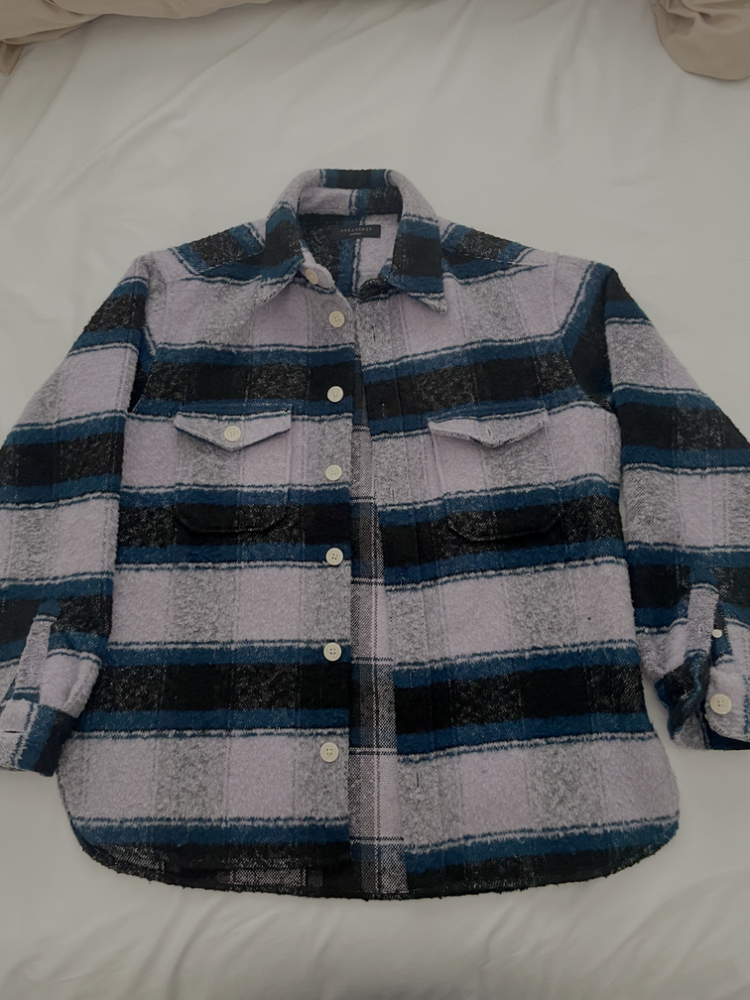

```json
{
  "Category": "Outerwear",
  "Type of clothing": "Shirt Jacket",
  "Primary Color": "Lavender",
  "Accent Color(s)": "Blue, Black",
  "Pattern": "Plaid",
  "Shape": "Structured",
  "Fit": "Relaxed",
  "Neckline": "Collared",
  "Key design elements": "Buttoned front, two chest pockets, buttoned cuffs",
  "Brand": "JACQUEMUS",
  "Style": "Classic/Traditional",
  "Occasion suitability": "Casual",
  "Weather appropriateness": "Cold",
  "Fabric Material": "Wool Blend",
  "Fabric Weight": "Medium",
  "Functional Features": "Not water-resistant, not moisture-wicking, not insulated",
  "How it can be styled": "Paired with jeans and boots for a casual look, or dressed up with chinos and loafers for a more polished appearance.",
  "Additional Notes": "The plaid pattern and lavender color make this jacket versatile for both autumn and winter seasons. Its relaxed fit and structured collar give it a timeless appeal."
}
```




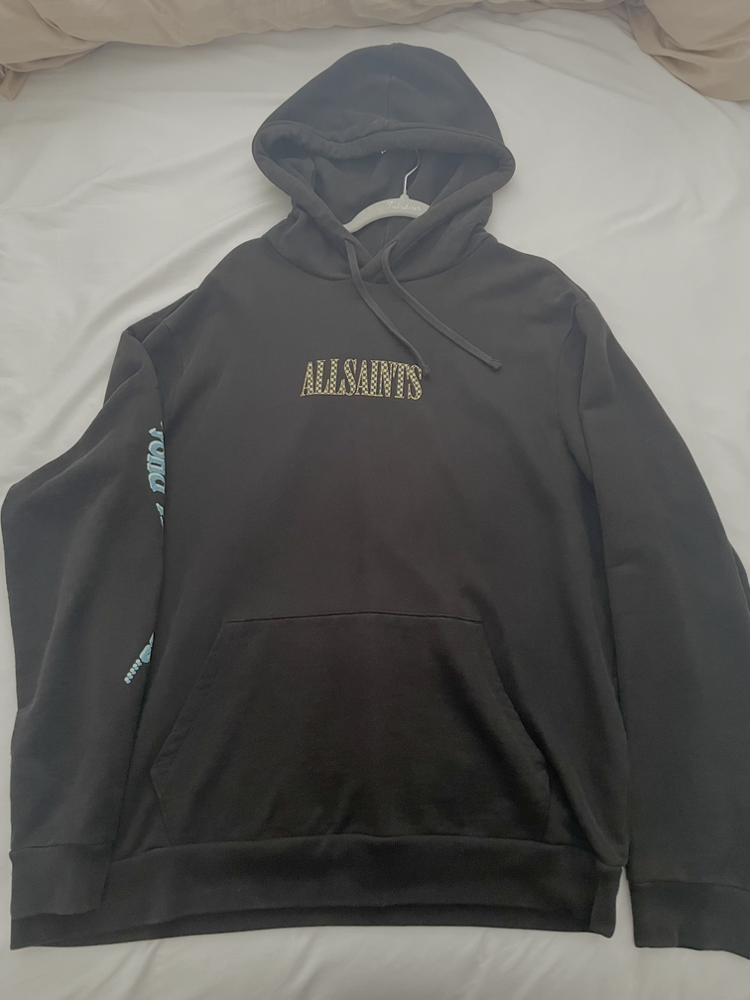

```json
{
  "Category": "Outerwear",
  "Type of clothing": "Hoodie",
  "Primary Color": "Black",
  "Accent Color(s)": "Gold",
  "Pattern": "Text",
  "Shape": "Standard",
  "Fit": "Relaxed",
  "Neckline": "Not applicable",
  "Key design elements": "Embroidered logo, drawstrings, front pocket",
  "Brand": "AllSaints",
  "Style": "Minimalist",
  "Occasion suitability": "Casual",
  "Weather appropriateness": "Cold",
  "Fabric Material": "Cotton",
  "Fabric Weight": "Medium",
  "Functional Features": "Not specified",
  "How it can be styled": "Paired with jeans and sneakers for a casual look, or layered under a jacket for a more dressed-up appearance.",
  "Additional Notes": "The hoodie features a clean and modern design with a subtle yet impactful embroidered logo, making it versatile for various casual settings."
}
```




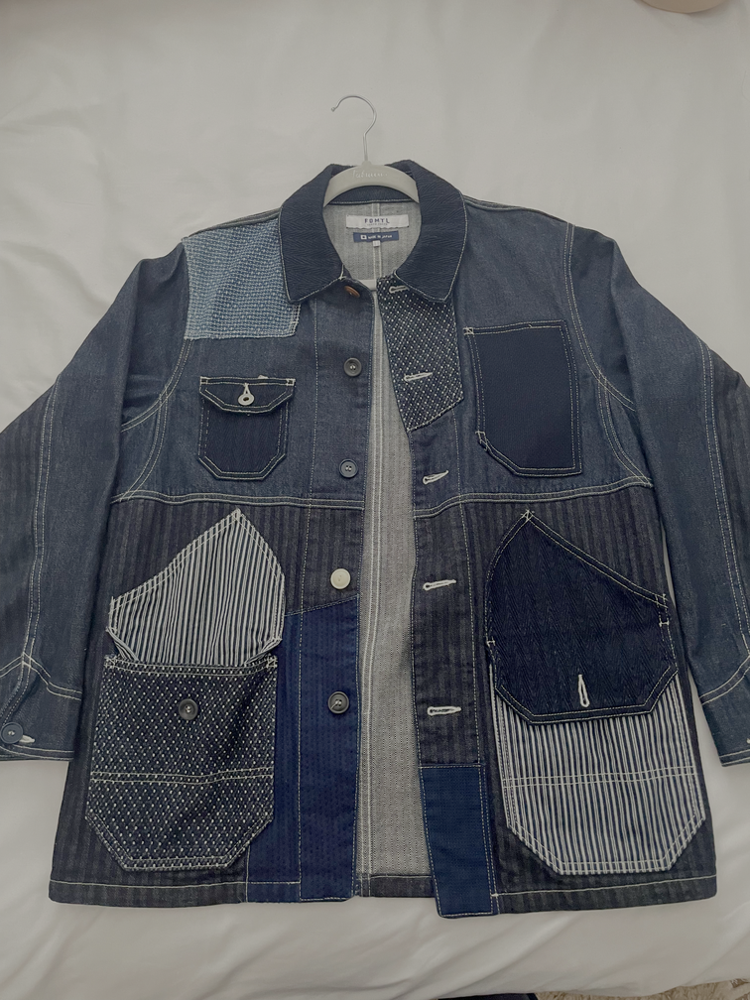

```json
{
  "Category": "Outerwear",
  "Type of clothing": "Denim Jacket",
  "Primary Color": "Blue",
  "Accent Color(s)": "White, Black",
  "Pattern": "Patchwork with various denim textures and stripes",
  "Shape": "Structured",
  "Fit": "Oversized",
  "Neckline": "Not applicable",
  "Key design elements": "Multiple pockets, button closures, decorative stitching, patchwork design",
  "Brand": "Tatsumi",
  "Style": "Streetwear",
  "Occasion suitability": "Casual",
  "Weather appropriateness": "All-season",
  "Fabric Material": "Denim",
  "Fabric Weight": "Medium",
  "Functional Features": "Not explicitly stated",
  "How it can be styled": "This denim jacket can be paired with jeans and a graphic t-shirt for a casual look, or dressed up with a button-down shirt and chinos for a more polished streetwear vibe.",
  "Additional Notes": "The patchwork design and oversized fit give this jacket a unique and edgy feel, making it a standout piece in any wardrobe."
}
```




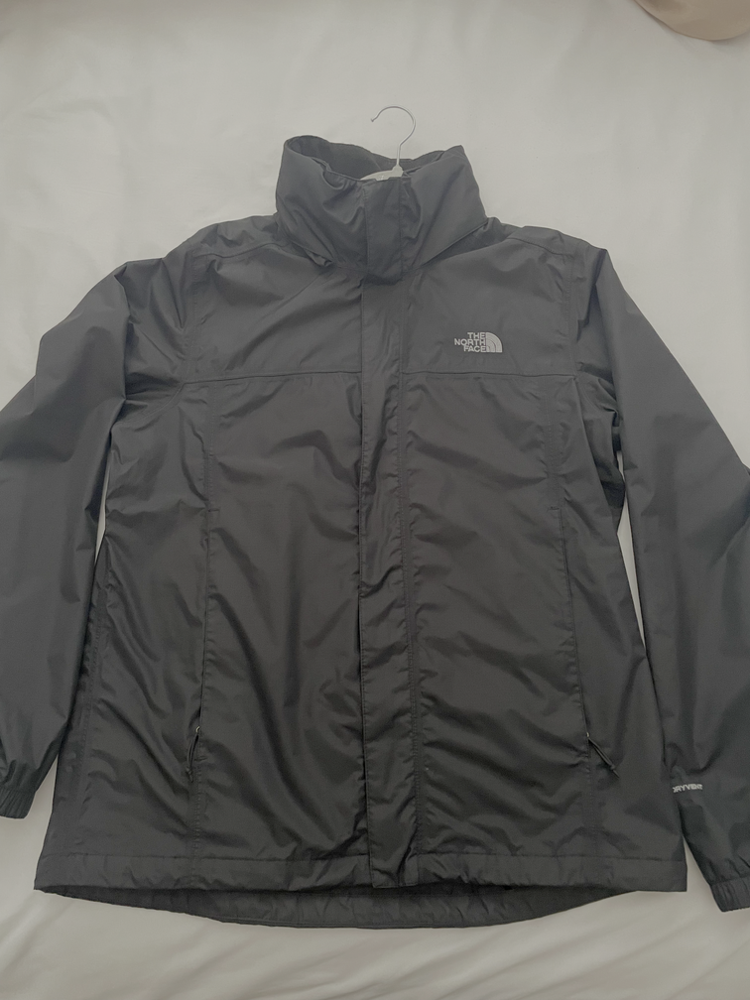

```json
{
  "Category": "Outerwear",
  "Type of clothing": "Rain Jacket",
  "Primary Color": "Dark Gray",
  "Accent Color(s)": "None",
  "Pattern": "Solid",
  "Shape": "Structured",
  "Fit": "Regular",
  "Neckline": "High Collar",
  "Key design elements": "Full-length zipper, hood, brand logo on chest, side pockets",
  "Brand": "The North Face",
  "Style": "Athletic",
  "Occasion suitability": "Casual",
  "Weather appropriateness": "Cold",
  "Fabric Material": "Synthetic",
  "Fabric Weight": "Medium",
  "Functional Features": "Water-resistant, windproof",
  "How it can be styled": "Paired with leggings and sneakers for a casual outdoor look; or dressed up with jeans and boots for a more rugged aesthetic.",
  "Additional Notes": "This jacket is designed for active use in wet conditions, offering both style and functionality. Its high collar and hood provide excellent protection against the elements."
}
```




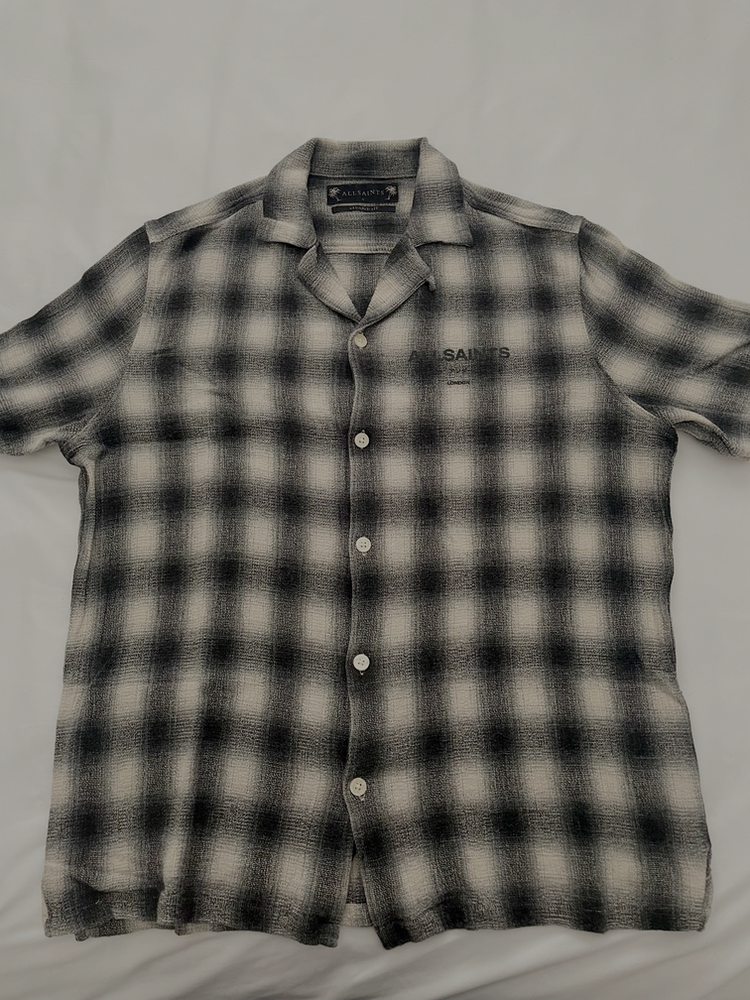

```json
{
  "Category": "Top",
  "Type of clothing": "Button-Up Shirt",
  "Primary Color": "Black",
  "Accent Color(s)": "White",
  "Pattern": "Checkered",
  "Shape": "Standard",
  "Fit": "Relaxed",
  "Neckline": "Collared",
  "Key design elements": "Buttons, Collar",
  "Brand": "AllSaints",
  "Style": "Minimalist",
  "Occasion suitability": "Casual",
  "Weather appropriateness": "Warm",
  "Fabric Material": "Cotton",
  "Fabric Weight": "Lightweight",
  "Functional Features": "Not applicable",
  "How it can be styled": "This shirt can be paired with jeans and sneakers for a casual weekend look or dressed up with chinos and loafers for a more polished appearance.",
  "Additional Notes": "The checkered pattern and relaxed fit make this shirt versatile and suitable for various casual settings. The black and white color scheme adds a timeless touch to any outfit."
}
```




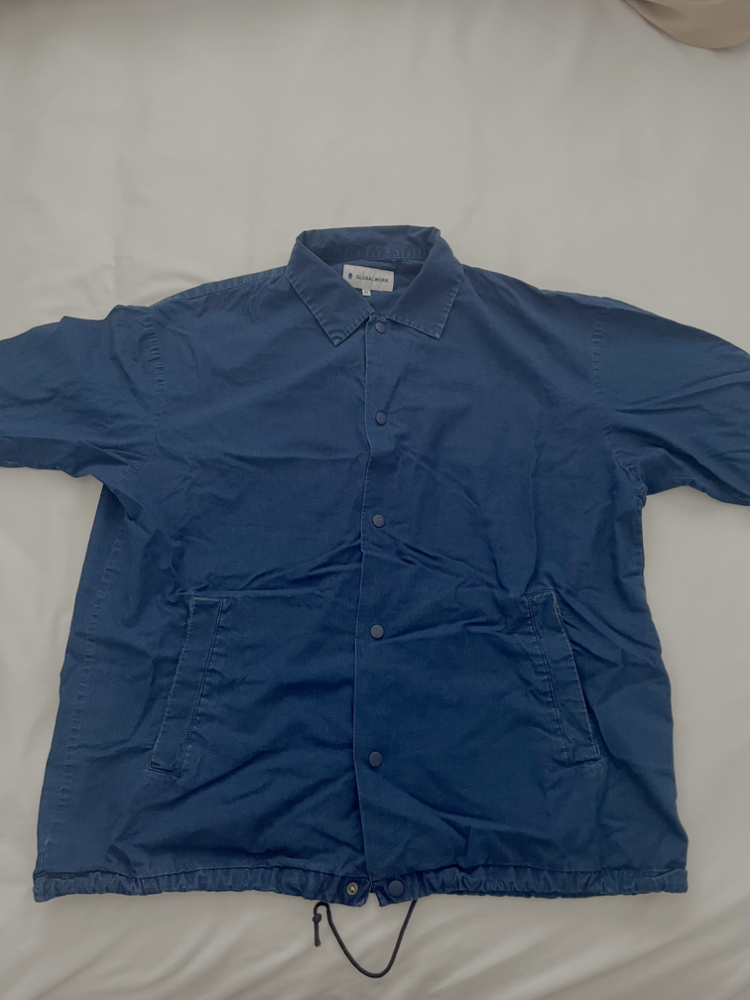

```json
{
  "Category": "Outerwear",
  "Type of clothing": "Shirt Jacket",
  "Primary Color": "Blue",
  "Accent Color(s)": "None",
  "Pattern": "Solid",
  "Shape": "Structured",
  "Fit": "Relaxed",
  "Neckline": "Collared",
  "Key design elements": "Buttoned front, two chest pockets, drawstring hem",
  "Brand": "Global Work",
  "Style": "Minimalist",
  "Occasion suitability": "Casual",
  "Weather appropriateness": "Warm",
  "Fabric Material": "Denim",
  "Fabric Weight": "Medium",
  "Functional Features": "Water-resistant",
  "How it can be styled": "Paired with jeans and sneakers for a casual look, or dressed up with chinos and loafers for a more polished appearance.",
  "Additional Notes": "The shirt jacket combines functionality with a clean, modern aesthetic, making it versatile for various casual settings."
}
```




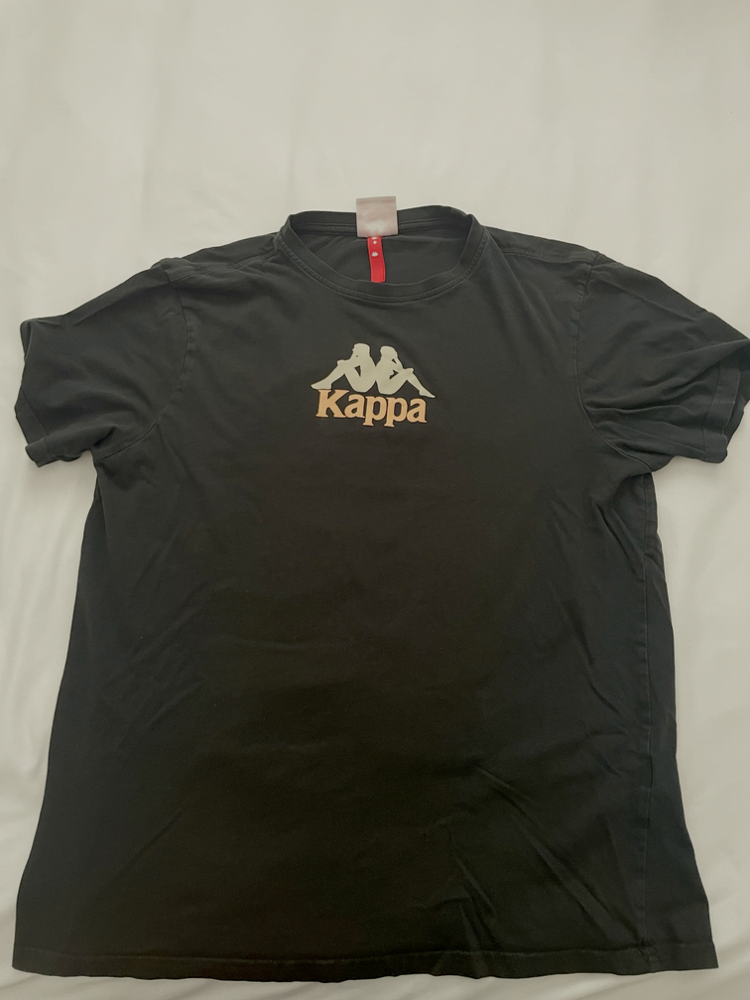

```json
{
  "Category": "Top",
  "Type of clothing": "T-Shirt",
  "Primary Color": "Black",
  "Accent Color(s)": "Gold",
  "Pattern": "Solid",
  "Shape": "Standard",
  "Fit": "Relaxed",
  "Neckline": "Round",
  "Key design elements": "Kappa logo with two stylized figures and the brand name in gold",
  "Brand": "Kappa",
  "Style": "Athleisure",
  "Occasion suitability": "Casual",
  "Weather appropriateness": "Warm",
  "Fabric Material": "Cotton",
  "Fabric Weight": "Lightweight",
  "Functional Features": "Not specified",
  "How it can be styled": "This T-shirt can be paired with jeans and sneakers for a casual weekend look or dressed up with chinos and loafers for a more polished athleisure vibe.",
  "Additional Notes": "The relaxed fit and comfortable cotton material make this T-shirt ideal for everyday wear, offering a blend of comfort and style."
}
```




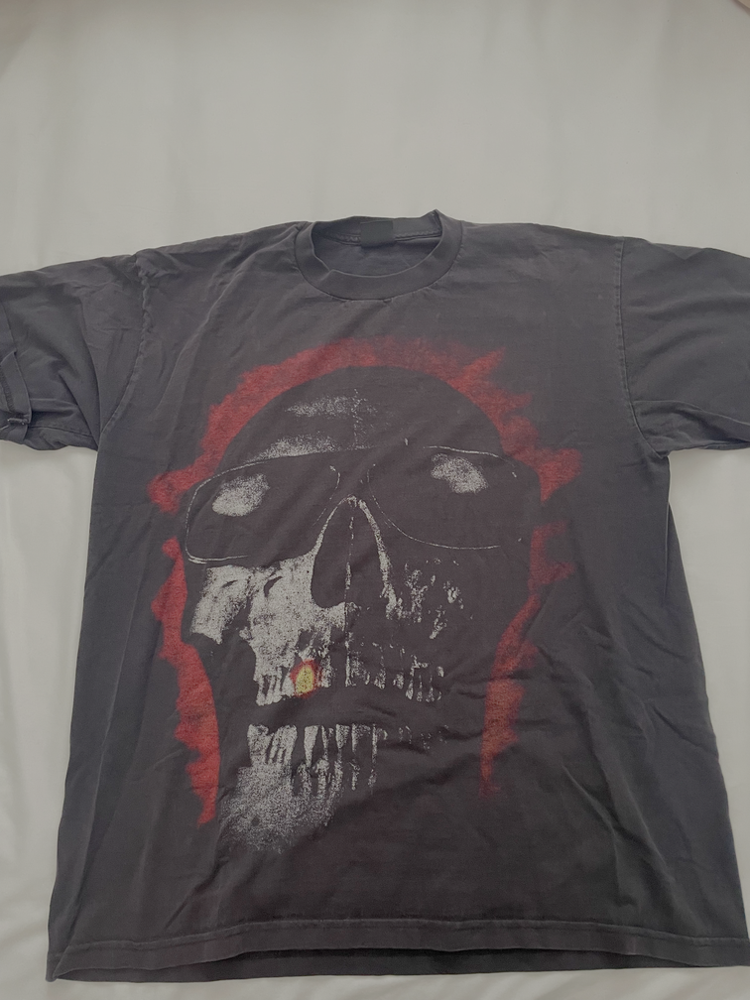

```json
{
  "Category": "Top",
  "Type of clothing": "T-Shirt",
  "Primary Color": "Dark Gray",
  "Accent Color(s)": "Red",
  "Pattern": "Skull with red accents",
  "Shape": "Standard T-Shirt shape",
  "Fit": "Oversized",
  "Neckline": "Crew",
  "Key design elements": "Skull graphic with red splatter details",
  "Brand": "Not specified",
  "Style": "Streetwear",
  "Occasion suitability": "Casual",
  "Weather appropriateness": "All-season",
  "Fabric Material": "Cotton",
  "Fabric Weight": "Medium weight",
  "Functional Features": "Not applicable",
  "How it can be styled": "This T-shirt can be paired with jeans and sneakers for a casual look, or layered under a jacket for a more dressed-up appearance.",
  "Additional Notes": "The dark gray base color combined with the bold red skull design creates a striking contrast, making this T-shirt a statement piece suitable for various casual settings."
}
```




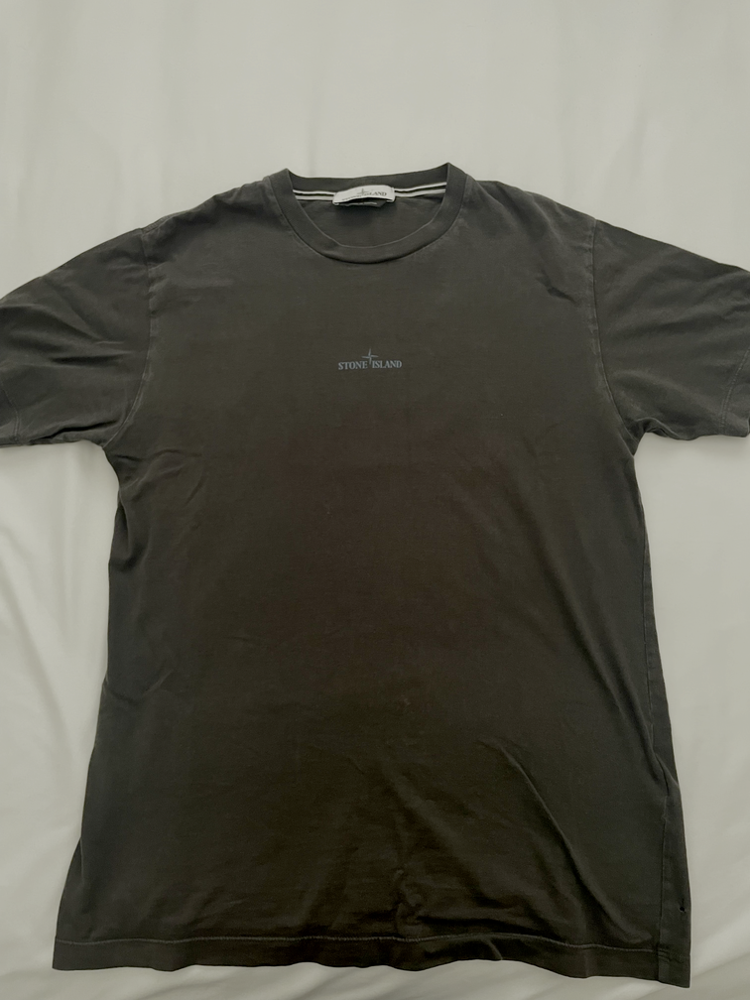

```json
{
  "Category": "Top",
  "Type of clothing": "T-Shirt",
  "Primary Color": "Dark Gray",
  "Accent Color(s)": "None",
  "Pattern": "Solid",
  "Shape": "Standard",
  "Fit": "Relaxed",
  "Neckline": "Crew",
  "Key design elements": "Stone Island logo embroidered on the chest",
  "Brand": "Stone Island",
  "Style": "Minimalist",
  "Occasion suitability": "Casual",
  "Weather appropriateness": "All-season",
  "Fabric Material": "Cotton",
  "Fabric Weight": "Medium",
  "Functional Features": "Not applicable",
  "How it can be styled": "This T-shirt can be paired with jeans and sneakers for a casual look, or dressed up with chinos and loafers for a more polished appearance.",
  "Additional Notes": "The Stone Island T-shirt exudes a timeless and understated elegance, suitable for both everyday wear and more formal occasions when paired with the right accessories."
}
```




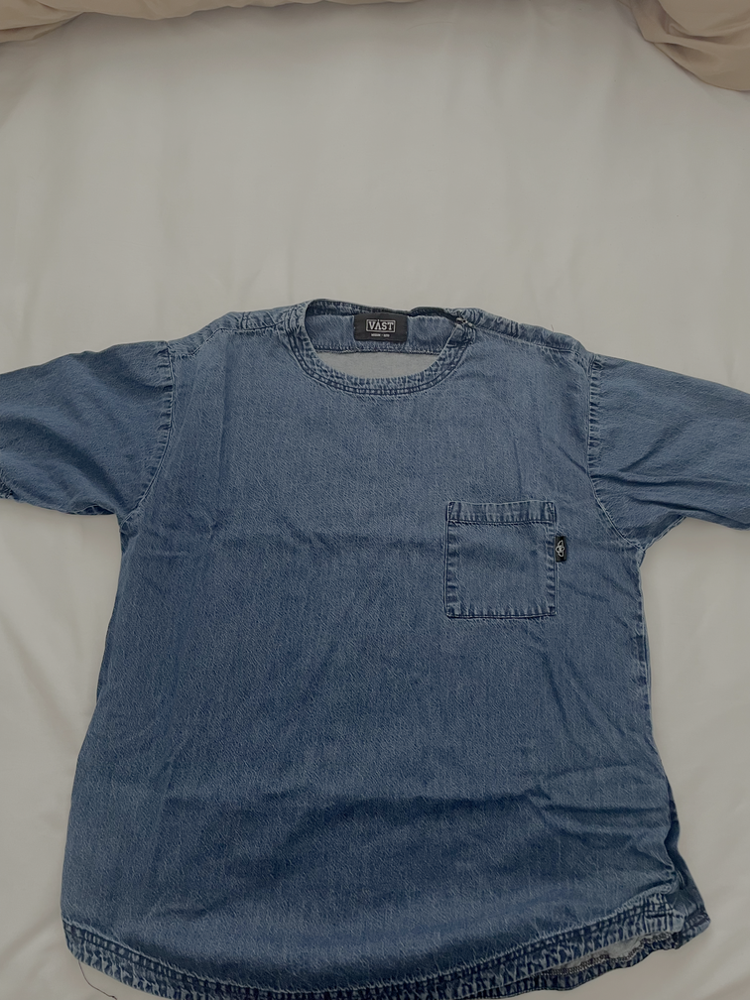

```json
{
  "Category": "Top",
  "Type of clothing": "Denim T-Shirt",
  "Primary Color": "Blue",
  "Accent Color(s)": "Black",
  "Pattern": "Solid",
  "Shape": "Regular",
  "Fit": "Relaxed",
  "Neckline": "Crew",
  "Key design elements": "Round neckline, chest pocket with button closure, brand label at the collar",
  "Brand": "VAST",
  "Style": "Minimalist",
  "Occasion suitability": "Casual",
  "Weather appropriateness": "Warm",
  "Fabric Material": "Denim",
  "Fabric Weight": "Medium",
  "Functional Features": "Not applicable",
  "How it can be styled": "This denim t-shirt can be paired with jeans and sneakers for a casual look, or dressed up with chinos and loafers for a more polished appearance.",
  "Additional Notes": "The relaxed fit and solid color make this t-shirt versatile for various casual settings. The chest pocket adds a functional element while maintaining a simple aesthetic."
}
```




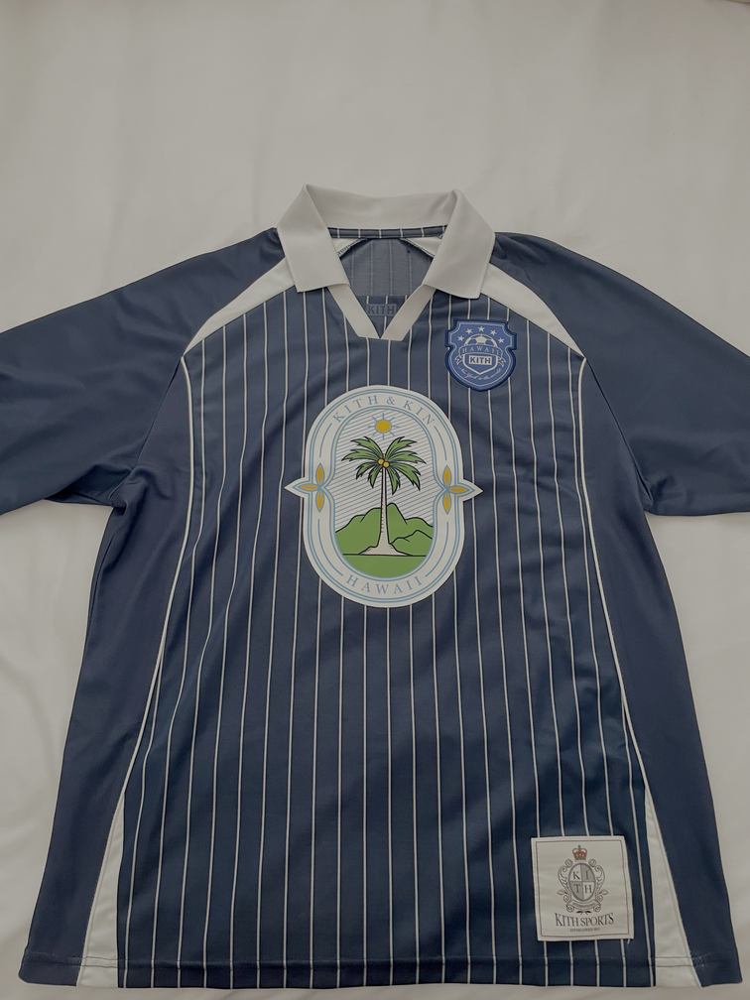

```json
{
  "Category": "Top",
  "Type of clothing": "Jersey",
  "Primary Color": "Navy Blue",
  "Accent Color(s)": "White",
  "Pattern": "Vertical Stripes",
  "Shape": "Standard Fit",
  "Fit": "Relaxed",
  "Neckline": "Collared",
  "Key design elements": "Central emblem featuring a palm tree, mountains, and sun, along with the text 'KITH & KIN HAWAII'. Small patches with similar designs on the shoulders and a tag on the lower right side.",
  "Brand": "KITH",
  "Style": "Athleisure",
  "Occasion suitability": "Casual",
  "Weather appropriateness": "Warm",
  "Fabric Material": "Polyester/Cotton Blend",
  "Fabric Weight": "Lightweight",
  "Functional Features": "Moisture-wicking",
  "How it can be styled": "Paired with shorts and sneakers for a casual summer look, or layered under a light jacket for a more dressed-up appearance.",
  "Additional Notes": "The jersey combines functionality with a tropical-inspired design, making it suitable for both everyday wear and light outdoor activitie

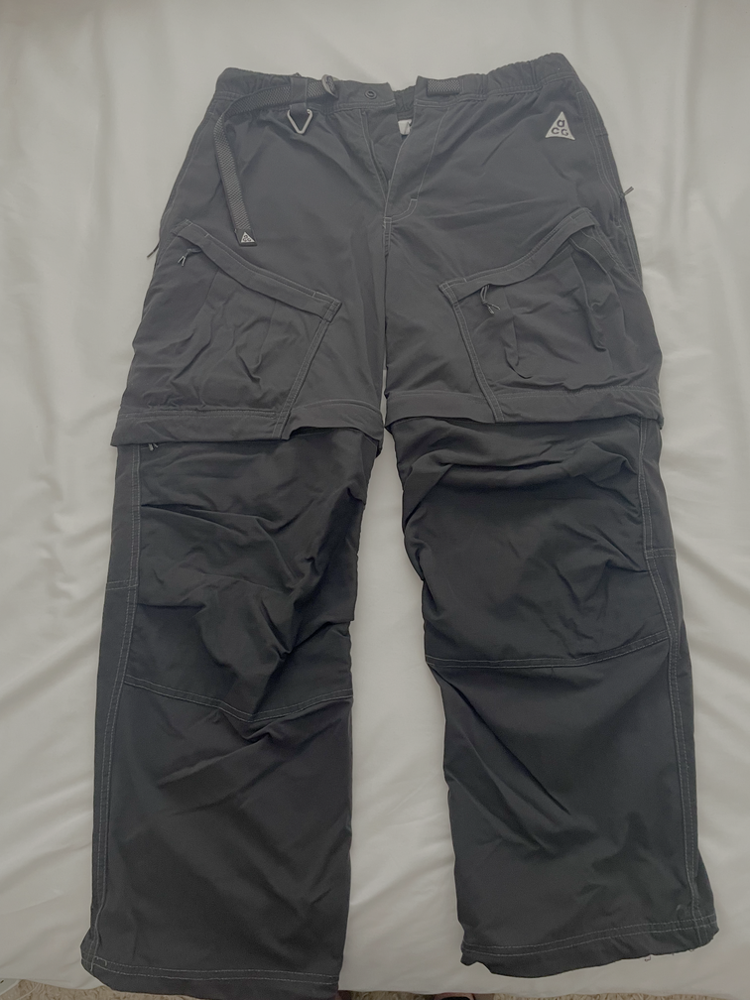

```json
{
  "Category": "Bottom",
  "Type of clothing": "Cargo Pants",
  "Primary Color": "Dark Gray",
  "Accent Color(s)": "Not applicable",
  "Pattern": "Solid",
  "Shape": "Straight-Leg",
  "Fit": "Relaxed",
  "Neckline": "Not applicable",
  "Key design elements": "Multiple pockets, adjustable waistband, reinforced stitching, brand logo",
  "Brand": "A-COLD-WALL*",
  "Style": "Minimalist, Streetwear",
  "Occasion suitability": "Casual",
  "Weather appropriateness": "Cold",
  "Fabric Material": "Polyester",
  "Fabric Weight": "Medium",
  "Functional Features": "Water-resistant, Moisture-wicking",
  "How it can be styled": "Paired with a simple t-shirt and sneakers for a casual look, or dressed up with a button-down shirt and boots for a more polished streetwear vibe.",
  "Additional Notes": "The A-COLD-WALL* cargo pants offer both functionality and style, making them versatile for various cold-weather activities while maintaining a sleek, modern aesthetic."
}
```




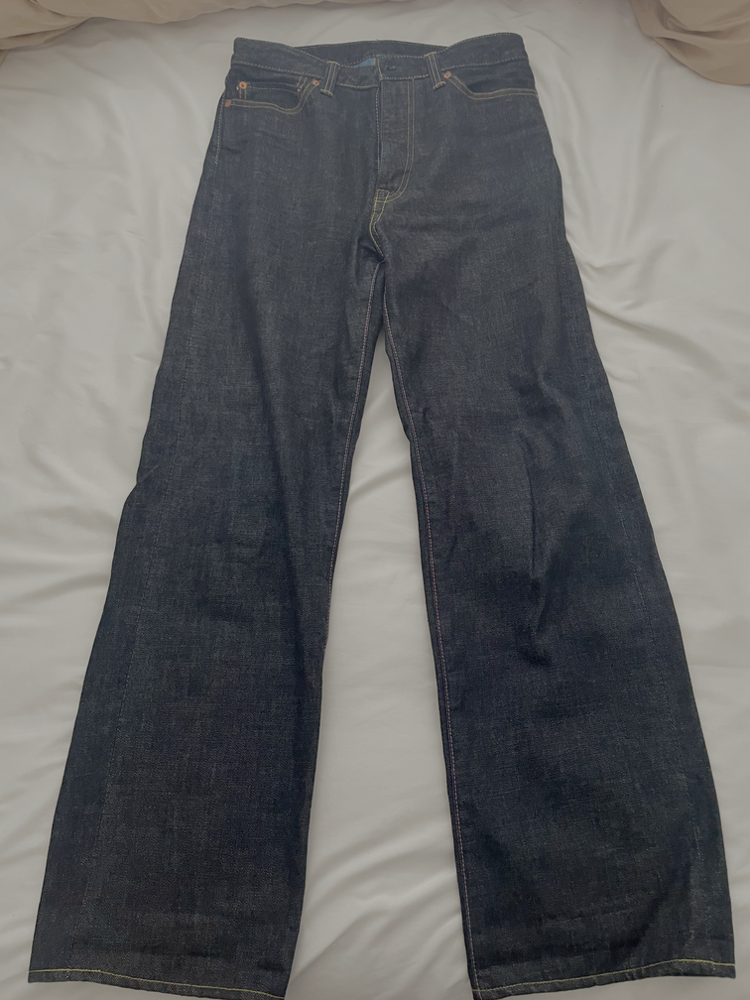

```json
{
  "Category": "Bottom",
  "Type of clothing": "Jeans",
  "Primary Color": "Dark Blue",
  "Accent Color(s)": "Yellow",
  "Pattern": "Solid",
  "Shape": "Straight-Leg",
  "Fit": "Relaxed",
  "Neckline": "Not applicable",
  "Key design elements": "Traditional five-pocket design, button fly, yellow stitching along the bottom hem",
  "Brand": "Levi's",
  "Style": "Classic/Traditional",
  "Occasion suitability": "Casual",
  "Weather appropriateness": "All-season",
  "Fabric Material": "Denim",
  "Fabric Weight": "Medium",
  "Functional Features": "Standard denim construction",
  "How it can be styled": "These jeans can be paired with a simple white t-shirt for a casual look or dressed up with a button-down shirt and loafers for a more polished appearance.",
  "Additional Notes": "The relaxed fit and classic design make these jeans versatile and suitable for everyday wear. The yellow stitching adds a subtle pop of color without overpowering the overall look."
}
```




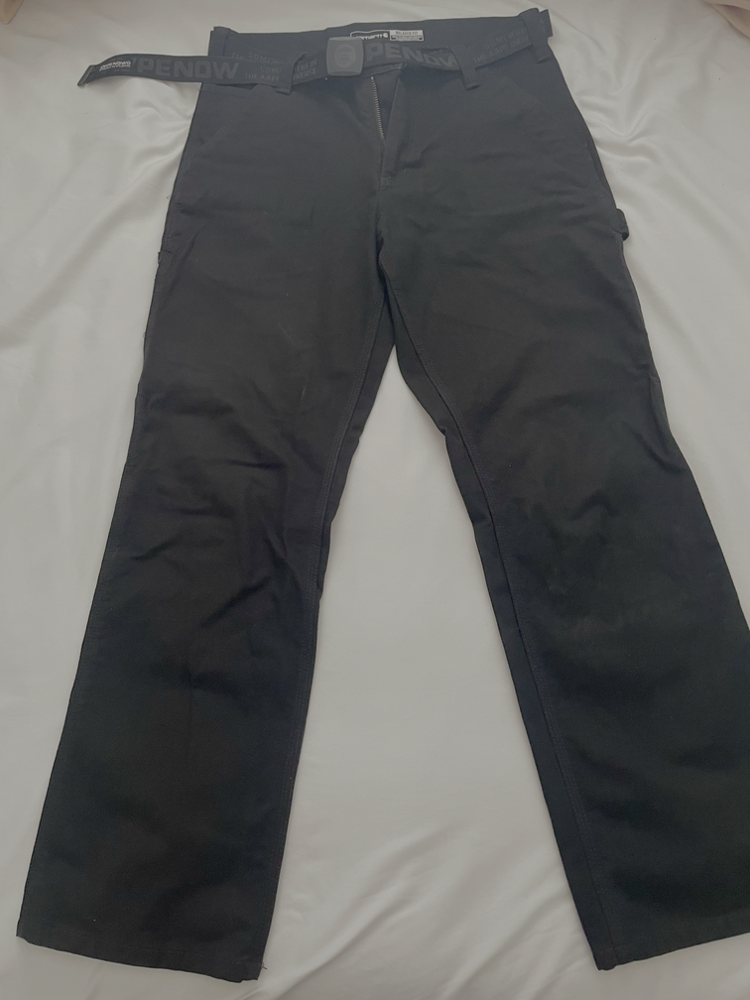

```json
{
  "Category": "Bottom",
  "Type of clothing": "Pants",
  "Primary Color": "Black",
  "Accent Color(s)": "N/A",
  "Pattern": "Solid",
  "Shape": "Straight leg",
  "Fit": "Relaxed",
  "Neckline": "Not applicable",
  "Key design elements": "Zipper fly, belt loops, brand label at waistband",
  "Brand": "RENOW",
  "Style": "Minimalist",
  "Occasion suitability": "Casual",
  "Weather appropriateness": "All-season",
  "Fabric Material": "Cotton",
  "Fabric Weight": "Medium",
  "Functional Features": "N/A",
  "How it can be styled": "These pants can be paired with a simple t-shirt for a casual look or dressed up with a button-down shirt and a blazer for a more polished appearance.",
  "Additional Notes": "The relaxed fit and solid black color make these pants versatile and suitable for various occasions, from everyday wear to slightly more formal settings."
}
```




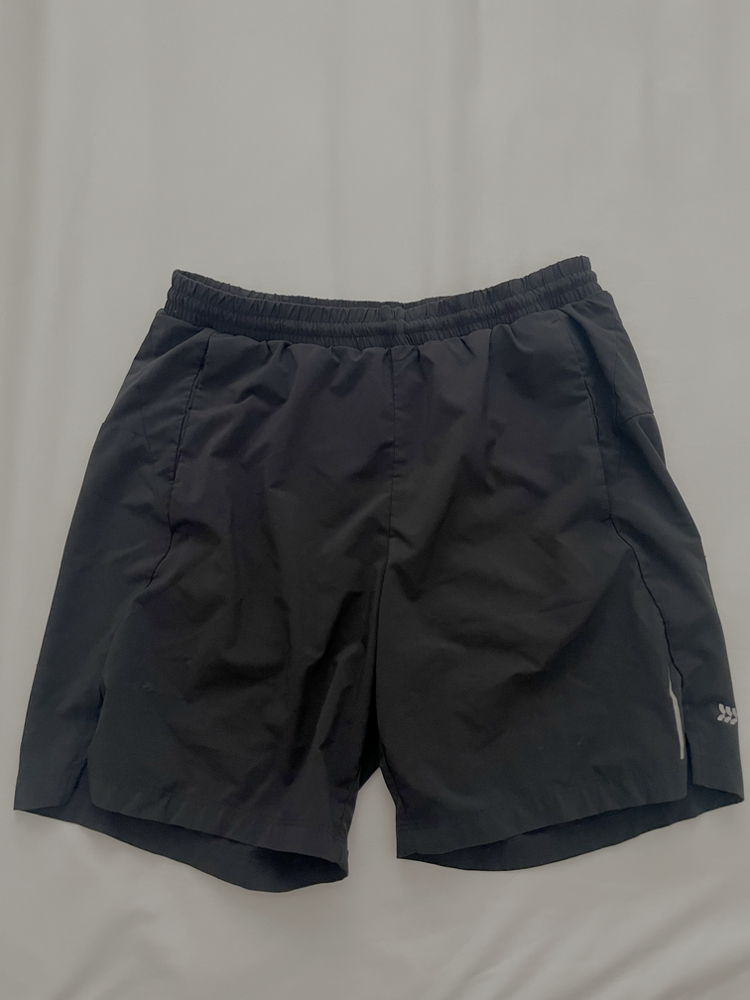

```json
{
  "Category": "Bottom",
  "Type of clothing": "Shorts",
  "Primary Color": "Black",
  "Accent Color(s)": "None",
  "Pattern": "Solid",
  "Shape": "Straight",
  "Fit": "Relaxed",
  "Neckline": "Not applicable",
  "Key design elements": "Elastic waistband, side pockets, small logo on the lower right leg",
  "Brand": "Not specified",
  "Style": "Athleisure",
  "Occasion suitability": "Casual",
  "Weather appropriateness": "Warm",
  "Fabric Material": "Polyester",
  "Fabric Weight": "Lightweight",
  "Functional Features": "Water-resistant",
  "How it can be styled": "These shorts can be paired with a simple t-shirt and sneakers for a casual look, or dressed up with a button-down shirt and loafers for a more polished athleisure vibe.",
  "Additional Notes": "The relaxed fit and water-resistant material make these shorts suitable for outdoor activities like hiking or running, while also being versatile enough for everyday wear."
}
```




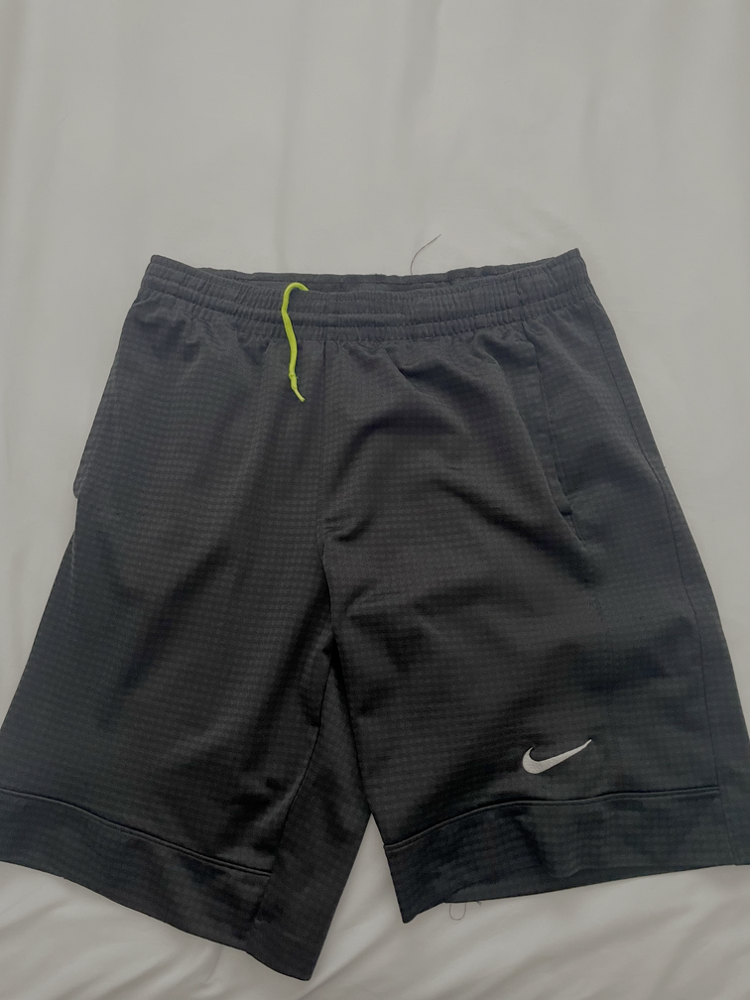

```json
{
  "Category": "Bottom",
  "Type of clothing": "Shorts",
  "Primary Color": "Dark Gray",
  "Accent Color(s)": "Bright Yellow",
  "Pattern": "Grid",
  "Shape": "Straight",
  "Fit": "Relaxed",
  "Neckline": "Not applicable",
  "Key design elements": "Elastic waistband with bright yellow drawstring, Nike logo on the lower right leg.",
  "Brand": "Nike",
  "Style": "Athleisure",
  "Occasion suitability": "Casual",
  "Weather appropriateness": "Warm",
  "Fabric Material": "Polyester",
  "Fabric Weight": "Lightweight",
  "Functional Features": "Moisture-wicking",
  "How it can be styled": "These shorts can be paired with a simple t-shirt and sneakers for a casual look, or dressed up with a button-down shirt and loafers for a more polished athleisure vibe.",
  "Additional Notes": "The relaxed fit and grid pattern give these shorts a modern and comfortable feel, making them suitable for both everyday wear and light workouts."
}
```




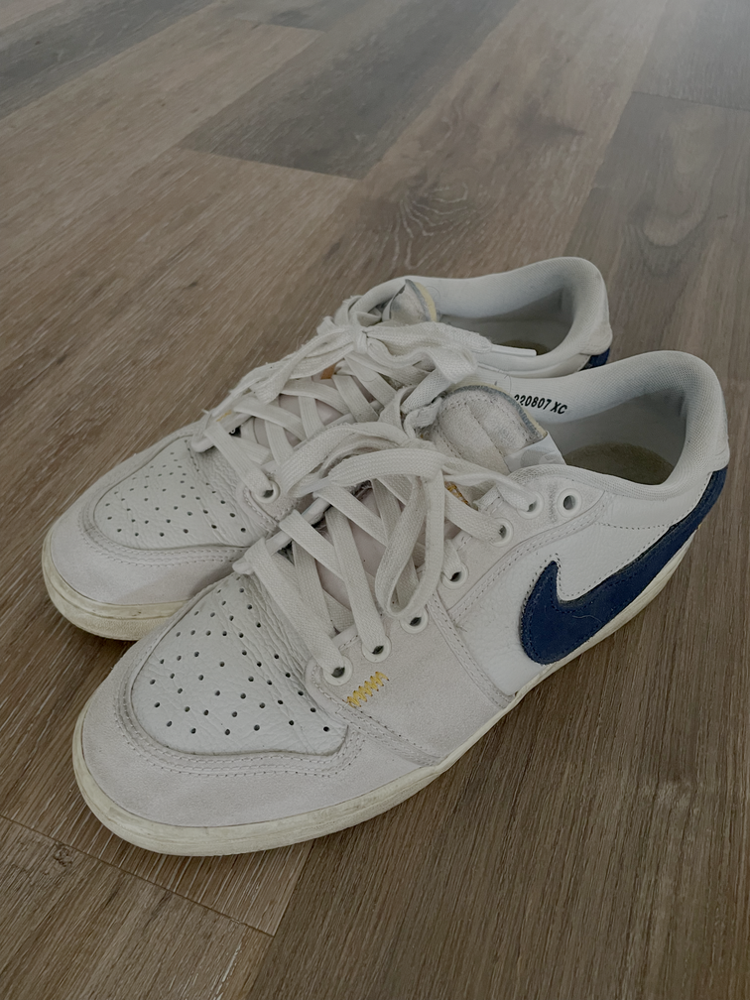

```json
{
  "Category": "Footwear",
  "Type of clothing": "Sneakers",
  "Primary Color": "White",
  "Accent Color(s)": "Blue",
  "Pattern": "Perforated",
  "Shape": "Low-top",
  "Fit": "Standard",
  "Neckline": "Not applicable",
  "Key design elements": "Laces, perforated toe cap, Nike swoosh logo, rubber sole",
  "Brand": "Nike",
  "Style": "Athleisure",
  "Occasion suitability": "Casual",
  "Weather appropriateness": "All-season",
  "Fabric Material": "Leather/Suede",
  "Fabric Weight": "Medium",
  "Functional Features": "Comfortable for everyday wear",
  "How it can be styled": "Can be paired with jeans and a graphic t-shirt for a casual look, or dressed up with chinos and a button-down shirt for a more polished appearance.",
  "Additional Notes": "These sneakers offer a blend of comfort and style, making them versatile for various occasions. The perforated design adds a touch of breathability and modern flair."
}
```




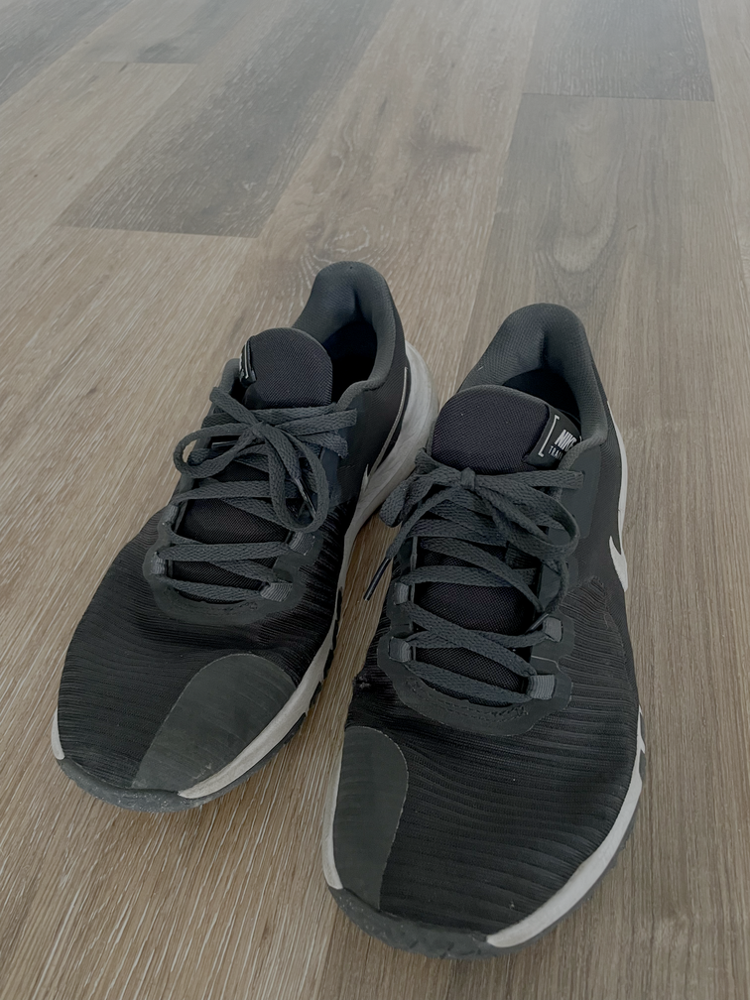

```json
{
  "Category": "Footwear",
  "Type of clothing": "Running Shoes",
  "Primary Color": "Black",
  "Accent Color(s)": "White",
  "Pattern": "Solid",
  "Shape": "Standard",
  "Fit": "Standard",
  "Neckline": "Not applicable",
  "Key design elements": "Lace-up closure, Nike swoosh logo, cushioned sole",
  "Brand": "Nike",
  "Style": "Athleisure",
  "Occasion suitability": "Casual, Sporty",
  "Weather appropriateness": "All-season",
  "Fabric Material": "Synthetic",
  "Fabric Weight": "Medium",
  "Functional Features": "Cushioned sole for comfort, lace-up closure for adjustability",
  "How it can be styled": "These running shoes can be paired with athletic shorts or leggings for a casual workout look, or dressed up with jeans and a t-shirt for a more relaxed athleisure vibe.",
  "Additional Notes": "The sleek black and white color scheme makes these shoes versatile for various athletic activities and casual outings. The cushioned sole ensures comfort during long runs or workouts."
}

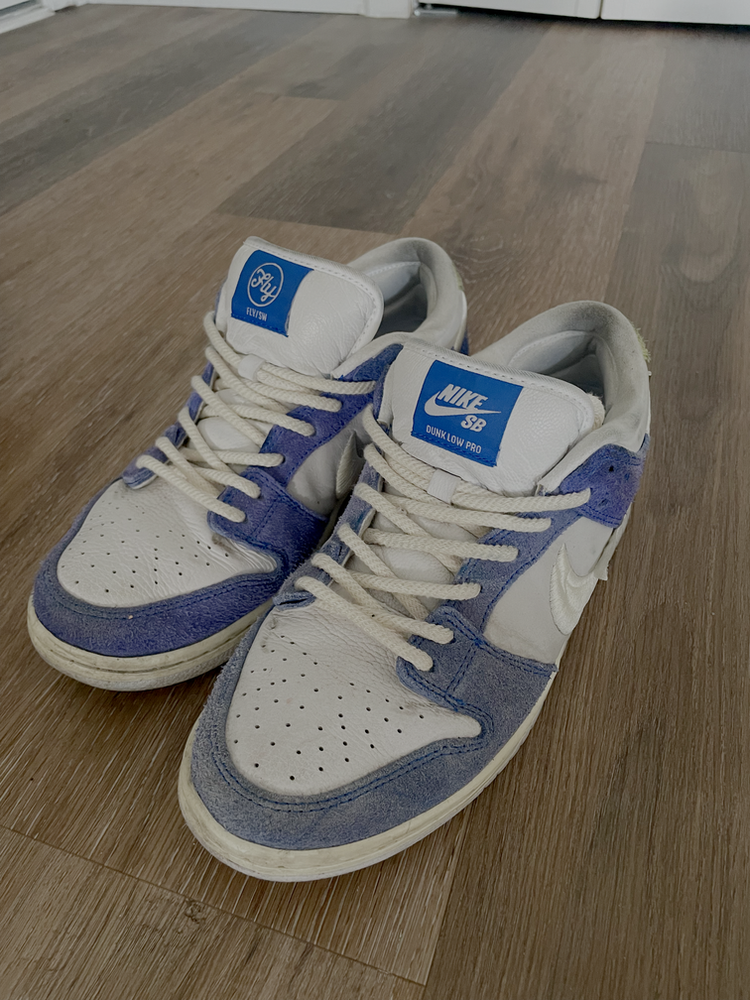

```json
{
  "Category": "Footwear",
  "Type of clothing": "Sneakers",
  "Primary Color": "White",
  "Accent Color(s)": "Blue",
  "Pattern": "Solid",
  "Shape": "Low-top",
  "Fit": "Standard",
  "Neckline": "Not applicable",
  "Key design elements": "Laces, tongue label, Nike SB logo, Fly logo",
  "Brand": "Nike SB",
  "Style": "Athletic, casual",
  "Occasion suitability": "Casual",
  "Weather appropriateness": "All-season",
  "Fabric Material": "Leather/Suede",
  "Fabric Weight": "Medium",
  "Functional Features": "Comfortable for athletic activities",
  "How it can be styled": "Can be paired with jeans and a graphic t-shirt for a casual look, or with shorts and a tank top for a summer vibe.",
  "Additional Notes": "These sneakers are versatile and suitable for everyday wear, offering both comfort and style."
}
```




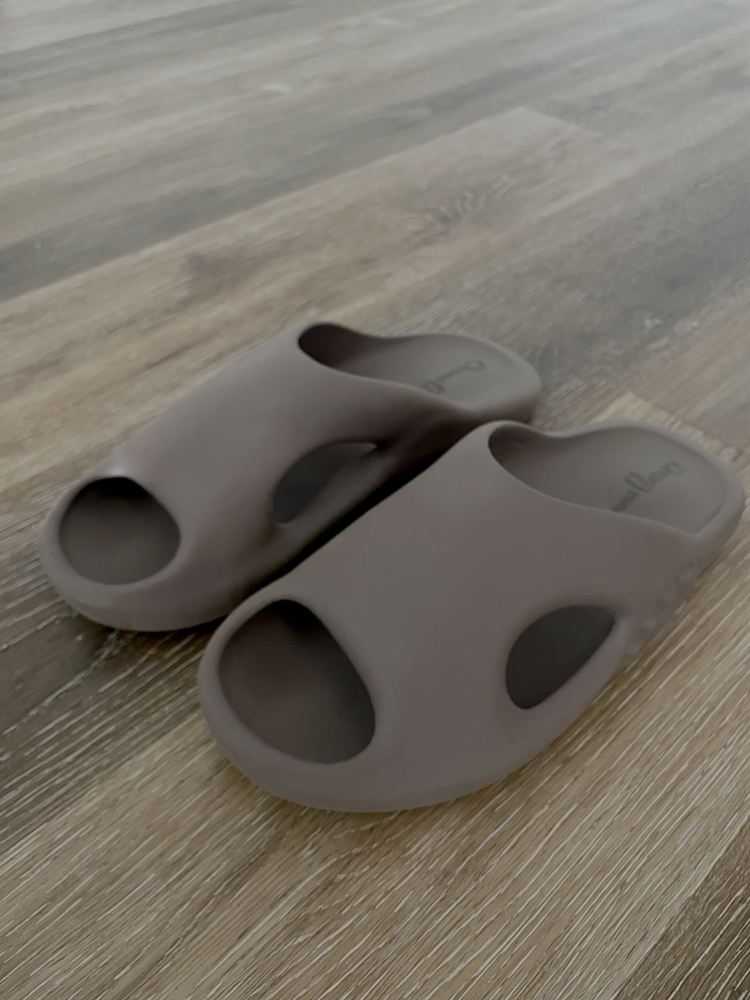

```json
{
  "Category": "Footwear",
  "Type of clothing": "Slippers",
  "Primary Color": "Muted Gray",
  "Accent Color(s)": "Not applicable",
  "Pattern": "Solid",
  "Shape": "Clog-style",
  "Fit": "Relaxed",
  "Neckline": "Not applicable",
  "Key design elements": "Comfortable footbed, open-toe design, minimal branding",
  "Brand": "Not specified",
  "Style": "Minimalist",
  "Occasion suitability": "Casual",
  "Weather appropriateness": "All-season",
  "Fabric Material": "Plastic or rubber",
  "Fabric Weight": "Lightweight",
  "Functional Features": "Water-resistant",
  "How it can be styled": "These slippers can be paired with a variety of outfits, such as a simple t-shirt and jeans for a relaxed look, or with a dress for a more chic and comfortable option.",
  "Additional Notes": "The minimalist design makes these slippers versatile for both indoor and outdoor use, suitable for everyday wear."
}
```




In [ ]:
# visualize images with generated description
for index, row in my_wardrobe.iterrows():
  image_path = row["image_path"]
  temp_path = reduce_image_size(image_path)
  display(Image(filename=temp_path))
  os.remove(temp_path)
  print(row['json_string'])
  print('\n')

Rough observations of the performance:
* Category had 100% accuracy
* Type of clothing is good too
* Brand hallucates sometimes when the logo / brand is not obvious
* Style seems to only use the given examples values from the prompt
* Fabric Material and Fabric Weight seems fairly accurate actually

Overall seems to be pretty accurate.

## Post Process Output into csv
Parse json string into pandas dataframe columns and save into csv file

In [ ]:
import json
import pandas as pd

def clean_json_string(json_string):
    # Find the start and end of the valid JSON string
    start_index = json_string.find("{")
    end_index = json_string.rfind("}") + 1
    valid_json_string = json_string[start_index:end_index]
    return valid_json_string

def parse_output(json_string: str) -> pd.DataFrame:
    """
    Parse a JSON string into a pandas DataFrame.

    Args:
        json_string (str): A string containing JSON data

    Returns:
        pd.DataFrame: A pandas DataFrame containing the parsed data

    Raises:
        ValueError: If the JSON string is invalid or empty
        TypeError: If the JSON data structure is not compatible with DataFrame conversion
    """
    # Check if input is empty or None
    if not json_string or json_string.isspace():
        raise ValueError("Input JSON string is empty or None")

    try:
        # Extract the valid JSON string
        valid_json_string = clean_json_string(json_string)

        # Parse JSON string into Python object
        data = json.loads(valid_json_string)

        # Data should be a single dictionary
        if isinstance(data, dict):
            return pd.DataFrame([data])
        else:
            raise TypeError("JSON structure is not a dictionary.")

    except json.JSONDecodeError as e:
        print(f"Error parsing JSON for index {index}: {e}")
        print(f"Offending string: {json_string}")
        raise ValueError(f"Invalid JSON string: {str(e)}")
    except Exception as e:
        print(f"Error parsing JSON for index {index}: {e}")
        print(f"Offending string: {row['json_string']}")
        raise Exception(f"Error parsing JSON: {str(e)}")

In [ ]:
# add each attribute/property as a column to my_wardrobe dataframe
for index, row in my_wardrobe.iterrows():
  df = parse_output(row['json_string'])
  for column in df.columns:
    my_wardrobe.loc[index, column] = df.loc[0, column]

my_wardrobe.head(5)

,image_path,json_string,Category,Type of clothing,Primary Color,Accent Color(s),Pattern,Shape,Fit,Neckline,Key design elements,Brand,Style,Occasion suitability,Weather appropriateness,Fabric Material,Fabric Weight,Functional Features,How it can be styled,Additional Notes
0,/content/drive/MyDrive/MIDS Capstone/my wardro...,"```json\n{\n ""Category"": ""Outerwear"",\n ""Typ...",Outerwear,Shirt Jacket,Lavender,"Blue, Black",Plaid,Structured,Relaxed,Collared,"Buttoned front, two chest pockets, buttoned cuffs",JACQUEMUS,Classic/Traditional,Casual,Cold,Wool Blend,Medium,"Not water-resistant, not moisture-wicking, not...","Paired with jeans and boots for a casual look,...",The plaid pattern and lavender color make this...
1,/content/drive/MyDrive/MIDS Capstone/my wardro...,"```json\n{\n ""Category"": ""Outerwear"",\n ""Typ...",Outerwear,Hoodie,Black,Gold,Text,Standard,Relaxed,Not applicable,"Embroidered logo, drawstrings, front pocket",AllSaints,Minimalist,Casual,Cold,Cotton,Medium,Not specified,Paired with jeans and sneakers for a casual lo...,The hoodie features a clean and modern design ...
2,/content/drive/MyDrive/MIDS Capstone/my wardro...,"```json\n{\n ""Category"": ""Outerwear"",\n ""Typ...",Outerwear,Denim Jacket,Blue,"White, Black",Patchwork with various denim textures and stripes,Structured,Oversized,Not applicable,"Multiple pockets, button closures, decorative ...",Tatsumi,Streetwear,Casual,All-season,Denim,Medium,Not explicitly stated,This denim jacket can be paired with jeans and...,The patchwork design and oversized fit give th...
3,/content/drive/MyDrive/MIDS Capstone/my wardro...,"```json\n{\n ""Category"": ""Outerwear"",\n ""Typ...",Outerwear,Rain Jacket,Dark Gray,None,Solid,Structured,Regular,High Collar,"Full-length zipper, hood, brand logo on chest,...",The North Face,Athletic,Casual,Cold,Synthetic,Medium,"Water-resistant, windproof",Paired with leggings and sneakers for a casual...,This jacket is designed for active use in wet ...
4,/content/drive/MyDrive/MIDS Capstone/my wardro...,"```json\n{\n ""Category"": ""Top"",\n ""Type of c...",Top,Button-Up Shirt,Black,White,Checkered,Standard,Relaxed,Collared,"Buttons, Collar",AllSaints,Minimalist,Casual,Warm,Cotton,Lightweight,Not applicable,This shirt can be paired with jeans and sneake...,The checkered pattern and relaxed fit make thi...


In [ ]:
# save output as csv
my_wardrobe.to_csv("/content/drive/MyDrive/MIDS Capstone/my_wardrobe_1.csv")